#YOLOv5

YOLOv5 is a family of object detection architectures and models pretrained on the COCO dataset, and represents Ultralytics open-source research into future vision AI methods, incorporating lessons learned and best practices evolved over thousands of hours of research and development.

## Performance

![alt text](https://raw.githubusercontent.com/vcasadei/images/master/yolov5.png)

### Pretrained Checkpoints

|Model |size<br><sup>(pixels) |mAP<sup>val<br>0.5:0.95 |mAP<sup>val<br>0.5 |Speed<br><sup>CPU b1<br>(ms) |Speed<br><sup>V100 b1<br>(ms) |Speed<br><sup>V100 b32<br>(ms) |params<br><sup>(M) |FLOPs<br><sup>@640 (B)
|---                    |---  |---    |---    |---    |---    |---    |---    |---
|YOLOv5n      |640  |28.0   |45.7   |**45** |**6.3**|**0.6**|**1.9**|**4.5**
|YOLOv5s     |640  |37.4   |56.8   |98     |6.4    |0.9    |7.2    |16.5
|YOLOv5m      |640  |45.4   |64.1   |224    |8.2    |1.7    |21.2   |49.0
|YOLOv5l      |640  |49.0   |67.3   |430    |10.1   |2.7    |46.5   |109.1
|YOLOv5x      |640  |50.7   |68.9   |766    |12.1   |4.8    |86.7   |205.7
|                       |     |       |       |       |       |       |       |
|YOLOv5n6     |1280 |36.0   |54.4   |153    |8.1    |2.1    |3.2    |4.6
|YOLOv5s6     |1280 |44.8   |63.7   |385    |8.2    |3.6    |12.6   |16.8
|YOLOv5m6     |1280 |51.3   |69.3   |887    |11.1   |6.8    |35.7   |50.0
|YOLOv5l6     |1280 |53.7   |71.3   |1784   |15.8   |10.5   |76.8   |111.4
|YOLOv5x6<br>+ TTA|1280<br>1536 |55.0<br>**55.8** |72.7<br>**72.7** |3136<br>- |26.2<br>- |19.4<br>- |140.7<br>- |209.8<br>-

![alt text](https://raw.githubusercontent.com/vcasadei/images/master/yolo_model_comparison.png)


# Custom Training with YOLOv5

In this tutorial, we assemble a dataset and train a custom YOLOv5 model to recognize the objects in our dataset. To do so we will take the following steps:

* Gather a dataset of images and label our dataset
* Export our dataset to YOLOv5
* Train YOLOv5 to recognize the objects in our dataset
* Evaluate our YOLOv5 model's performance
* Run test inference to view our model at work



# Step 1: Install Requirements

In [1]:
#clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 14469, done.
remote: Total 14469 (delta 0), reused 0 (delta 0), pack-reused 14469
Receiving objects: 100% (14469/14469), 13.41 MiB | 24.18 MiB/s, done.
Resolving deltas: 100% (9990/9990), done.
/content/yolov5
     |████████████████████████████████| 1.6 MB 4.7 MB/s 
     |████████████████████████████████| 41 kB 115 kB/s 
     |████████████████████████████████| 178 kB 8.4 MB/s 
     |████████████████████████████████| 145 kB 57.7 MB/s 
     |████████████████████████████████| 67 kB 3.8 MB/s 
     |████████████████████████████████| 54 kB 2.4 MB/s 
     |████████████████████████████████| 138 kB 54.4 MB/s 
     |████████████████████████████████| 62 kB 885 kB/s 
Setup complete. Using torch 1.12.1+cu113 (Tesla T4)


In [2]:
!pip install joblib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="bLUYEL01Rxll3FTeOLX0")
project = rf.workspace("cesar-oayyo").project("frutasof")
dataset = project.version(3).download("yolov5")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Frutasof-3 in yolov5pytorch:: 100%|██████████| 316/316 [00:00<00:00, 436.33it/s]


# Step 3: Train Our Custom YOLOv5 model

Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** Our dataset locaiton is saved in the `dataset.location`
- **weights:** specify a path to weights to start transfer learning from. Here we choose the generic COCO pretrained checkpoint.
- **cache:** cache images for faster training

###Visualize
**Weights & Biases Logging**

Weights & Biases (W&B) is now integrated with YOLOv5 for real-time visualization and cloud logging of training runs. This allows for better run comparison and introspection, as well improved visibility and collaboration among team members. To enable W&B logging install wandb, and then train normally (you will be guided setup on first use).

During training you will see live updates at https://wandb.ai, and you can create Detailed Reports of your results using the W&B Reports tool.

In [4]:
# Tensorboard  (optional)
%load_ext tensorboard
%tensorboard --logdir runs/train

<IPython.core.display.Javascript object>

In [5]:
# Weights & Biases  (optional)
%pip install -q wandb
import wandb

     |████████████████████████████████| 1.9 MB 5.2 MB/s 
     |████████████████████████████████| 166 kB 64.7 MB/s 
     |████████████████████████████████| 182 kB 49.3 MB/s 
     |████████████████████████████████| 63 kB 1.9 MB/s 
     |████████████████████████████████| 140 kB 61.0 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
roboflow 0.2.18 requires urllib3==1.26.6, but you have urllib3 1.26.12 which is incompatible.


In [6]:
import sys

def wandb_colab_login():
  """Temporary hack to prevent colab from hanging"""
  sys.modules["google.colab2"] = sys.modules["google.colab"]
  del sys.modules["google.colab"]
  wandb.login()
  sys.modules["google.colab"] = sys.modules["google.colab2"]
wandb_colab_login()

ERROR:wandb.jupyter:Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


<IPython.core.display.Javascript object>

wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [7]:
from google.colab import drive

drive.mount('/content/gdrive/')

Mounted at /content/gdrive/


In [14]:
!python train.py --img 640 --batch 10 --epochs 300 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

wandb: Currently logged in as: alyson (alysonlaurentino). Use `wandb login --relogin` to force relogin
train: weights=yolov5s.pt, cfg=, data=/content/yolov5/Frutasof-3/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=300, batch_size=10, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-225-g02b8a4c Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1

In [16]:
%cp -r /content/yolov5/runs/train /content/gdrive/MyDrive/Frutastepps/

# Evaluate Custom YOLOv5 Detector Performance
Training losses and performance metrics are saved to Tensorboard and also to a logfile.

If you are new to these metrics, the one you want to focus on is `mAP_0.5` - learn more about mean average precision [here](https://blog.roboflow.com/mean-average-precision/).

In [17]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6007 (pid 1379), started 0:14:18 ago. (Use '!kill 1379' to kill it.)

<IPython.core.display.Javascript object>

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [18]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source {dataset.location}/test/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/yolov5/Frutasof-3/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-225-g02b8a4c Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7020913 parameters, 0 gradients, 15.8 GFLOPs
image 1/6 /content/yolov5/Frutasof-3/test/images/melancia_17_jpg.rf.e1577101b297a5b82cc4163aa3e1d3fb.jpg: 288x416 1 melancia, 12.2ms
image 2/6 /content/yolov5/Frutasof-3/test/images/pear_31_jpg.rf.b0d73d6ba6c7937d6e5c89118136eeb3.jpg: 416x416 1 pera, 8.2ms
image 3/6 /content/yolov5/Frutasof-3/test/images/pear_3_jpg.rf.b232ec55

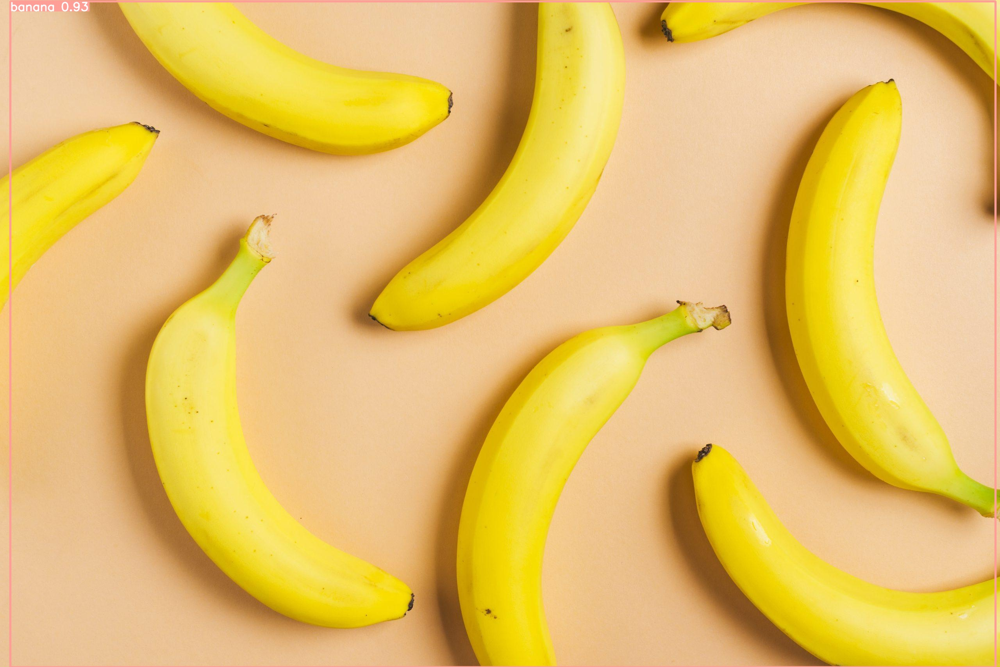

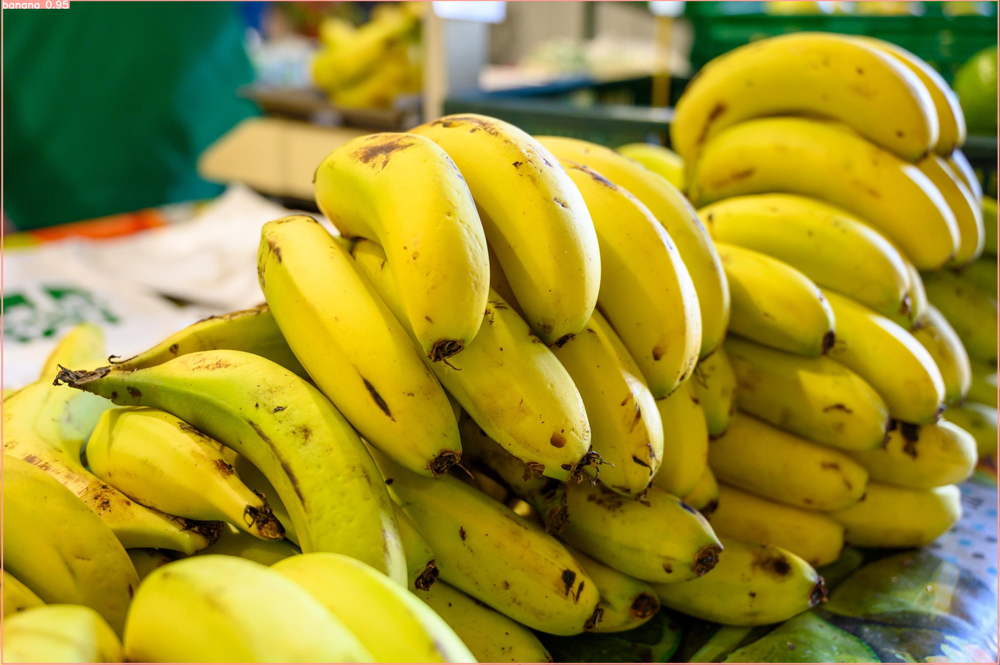

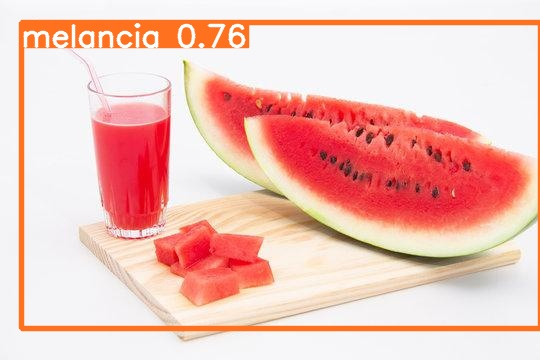

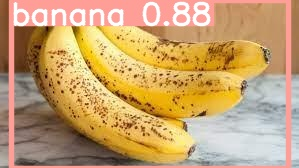

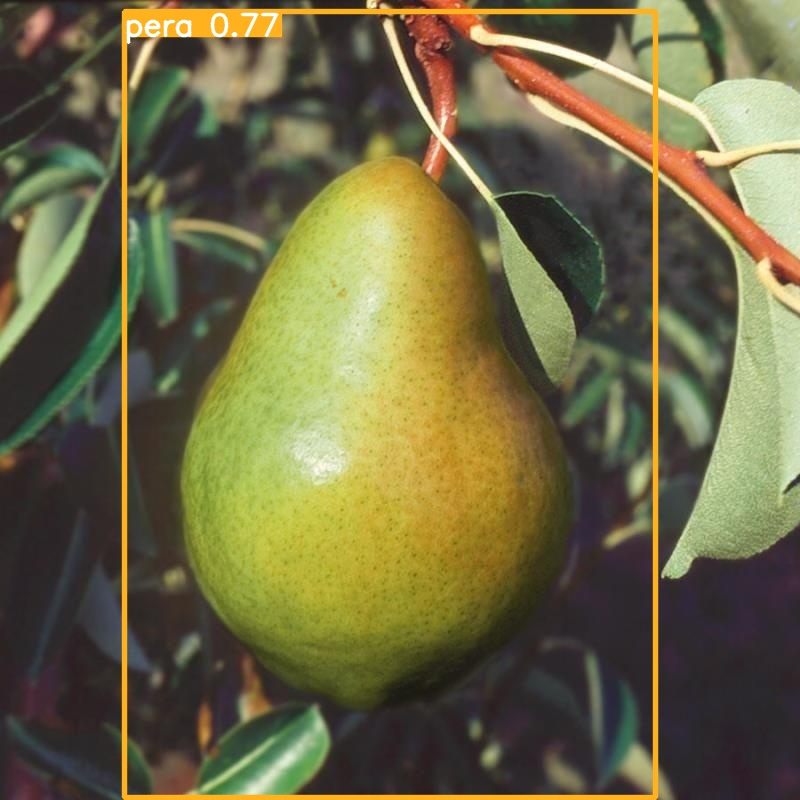

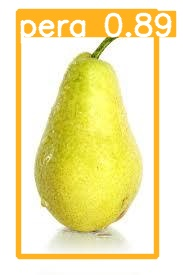

In [20]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Conclusion and Next Steps

Congratulations! You've trained a custom YOLOv5 model to recognize your custom objects.

To improve you model's performance, we recommend first interating on your datasets coverage and quality. See this guide for [model performance improvement](https://github.com/ultralytics/yolov5/wiki/Tips-for-Best-Training-Results).

To deploy your model to an application, see this guide on [exporting your model to deployment destinations](https://github.com/ultralytics/yolov5/issues/251).

Once your model is in production, you will want to continually iterate and improve on your dataset and model via [active learning](https://blog.roboflow.com/what-is-active-learning/).

In [22]:
#export your model's weights for future use
from google.colab import files
files.download('./runs/train/exp/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>